# Predicting Housing Data

Datos:

* [House Prices - Advanced Regression Techniques](https://www.kaggle.com/competitions/house-prices-advanced-regression-techniques)

In [5]:
import numpy as np
import pandas as pd
import seaborn as sns
from matplotlib import pyplot as plt

## Load data

In [9]:
train_data = pd.read_csv("../data/raw/train.csv")
test_data = pd.read_csv("../data/raw/test.csv")
test_ids = test_data['Id']
print("Shape:", train_data.shape)
print("Duplicated data :", train_data.duplicated().sum())

Shape: (1460, 81)
Duplicated data : 0


## Some EDA

<AxesSubplot: >

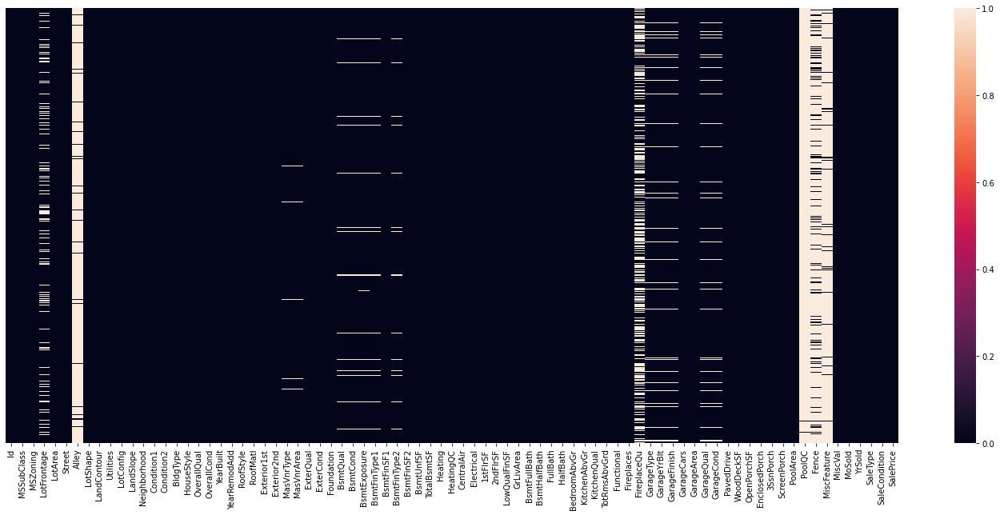

In [10]:
fig, ax = plt.subplots(figsize=(25,10))
sns.heatmap(data=train_data.isnull(), yticklabels=False, ax=ax)

C:\Users\mb79312\AppData\Local\Temp\1\ipykernel_4340\4253544134.py:5: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(x=train_data["Foundation"], y=train_data["SalePrice"], palette='deep', ax=ax)


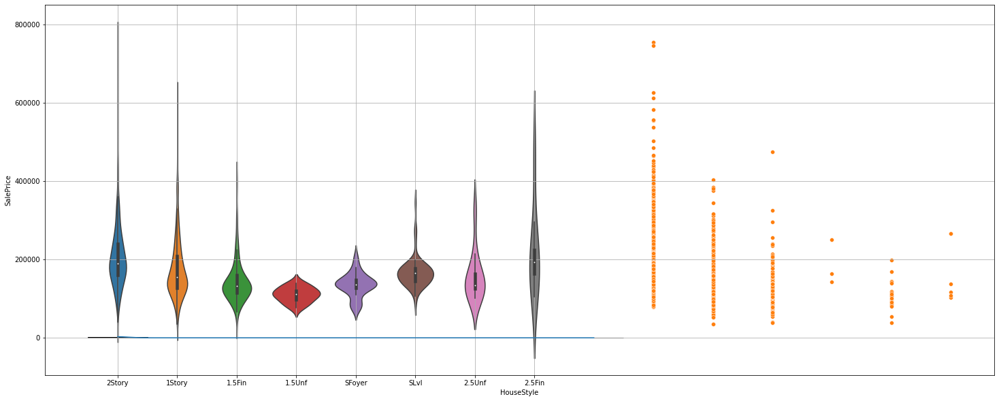

In [11]:
fig, ax = plt.subplots(figsize=(25,10))
sns.countplot(x=train_data['SaleCondition'])
sns.histplot(x=train_data['SaleType'], kde=True, ax=ax)
sns.violinplot(x=train_data['HouseStyle'], y=train_data['SalePrice'],ax=ax)
sns.scatterplot(x=train_data["Foundation"], y=train_data["SalePrice"], palette='deep', ax=ax)
plt.grid()

## Fill missing data

In [18]:
# train_data['FireplaceQu'].fillna("No", inplace=True)
# train_data['BsmtQual'].fillna("No", inplace=True)
# train_data['BsmtCond'].fillna("No", inplace=True)
# train_data['BsmtFinType1'].fillna("No", inplace=True)
# train_data['BsmtFinType2'].fillna("No", inplace=True)
# train_data['BsmtFinType2'].fillna("None", inplace=True)


def fill_all_missing_values(data, cols_ob = []):
    for col in data.columns:
        if((data[col].dtype == 'float64') or (data[col].dtype == 'int64')):
            data[col].fillna(data[col].mean())
        elif data[col].dtype == 'object' and col in list(cols_ob.keys()):
            data[col] = data[col].fillna(cols_ob[col])
    return data


cols =  {'FireplaceQu': 'No',
    'BsmtQual':'No',
    'BsmtCond': 'No',
    'BsmtFinType1': 'No',
    'BsmtFinType2': "None"}
train_data = fill_all_missing_values(train_data, cols)

## Drop unwanted data

In [20]:
drop_col = ['Id', 'Alley', 'PoolQC', 'MiscFeature', 'Fence', 'MoSold', 'YrSold', 'MSSubClass',
            'GarageType', 'GarageArea', 'GarageYrBlt', 'GarageFinish', 'YearRemodAdd', 'LandSlope',
            'BsmtUnfSF', 'BsmtExposure', '2ndFlrSF', 'LowQualFinSF', 'Condition1', 'Condition2', 'Heating',
             'Exterior1st', 'Exterior2nd', 'HouseStyle', 'LotShape', 'LandContour', 'LotConfig', 'Functional',
             'BsmtFinSF1', 'BsmtFinSF2', 'FireplaceQu', 'WoodDeckSF', 'GarageQual', 'GarageCond', 'OverallCond'
           ]

train_data.drop(drop_col, axis=1, inplace=True)
test_data.drop(drop_col, axis=1, inplace=True)

## Preprocessing

In [21]:
from sklearn.preprocessing import OrdinalEncoder
def ordinal_encoder(train_data, test_data, key, value):
    OE = OrdinalEncoder(categories=[value])
    train_data[key] = OE.fit_transform(train_data[[key]])
    test_data[key] = OE.transform(test_data[[key]])
    return train_data, test_data
    

In [ ]:
dict_params = {'BsmtQual': ['No', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],
               'BsmtCond': ['No', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],
               'ExterQual':['Po', 'Fa', 'TA', 'Gd', 'Ex'],
               'ExterCond': ['Po', 'Fa', 'TA', 'Gd', 'Ex'],
               'KitchenQual': ['Po', 'Fa', 'TA', 'Gd', 'Ex'],
               'PavedDrive':['N', 'P', 'Y'],
               'Electrical':['Mix', 'FuseP', 'FuseF', 'FuseA', 'SBrkr'],
               'BsmtFinType1':['No', 'Unf', 'LwQ', 'Rec', 'BLQ', 'ALQ', 'GLQ'],
               'BsmtFinType2': ['No', 'Unf', 'LwQ', 'Rec', 'BLQ', 'ALQ', 'GLQ'],
               'Utilities':['ELO', 'NoSeWa', 'NoSewr', 'AllPub'],
               'MSZoning':['C (all)', 'RH', 'RM', 'RL', 'FV'],
               'Foundation':['Slab', 'BrkTil', 'Stone', 'CBlock', 'Wood', 'PConc'],
               'Neighborhood':['MeadowV', 'IDOTRR', 'BrDale', 'Edwards', 'BrkSide', 'OldTown', 'NAmes', 'Sawyer', 'Mitchel', 'NPkVill', 'SWISU', 'Blueste', 'SawyerW', 'NWAmes', 'Gilbert', 'Blmngtn', 'ClearCr', 'Crawfor', 'CollgCr', 'Veenker', 'Timber', 'Somerst', 'NoRidge', 'StoneBr', 'NridgHt'],
               'MasVnrType':['None', 'BrkCmn', 'BrkFace', 'Stone'],
               'SaleCondition':['AdjLand', 'Abnorml','Alloca', 'Family', 'Normal', 'Partial'],
               'RoofStyle':['Gambrel', 'Gable','Hip', 'Mansard', 'Flat', 'Shed'],
               'RoofMatl':['ClyTile', 'CompShg', 'Roll','Metal', 'Tar&Grv','Membran', 'WdShake', 'WdShngl']
}

for k, v in dict_params.items():
    train_data, test_data = ordinal_encoder(train_data, test_data, k, v)

In [8]:
Level_col = ['Street' ,'BldgType', 'SaleType', 'CentralAir']

from sklearn.preprocessing import LabelEncoder
encoder = LabelEncoder()
def encode_catagorical_columns(train, test):
    for col in Level_col:
        train[col] = encoder.fit_transform(train[col])
        test[col]  = encoder.transform(test[col])
encode_catagorical_columns(train_data, test_data)

In [9]:
train_data['BsmtRating'] = train_data['BsmtCond'] * train_data['BsmtQual']
train_data['ExterRating'] = train_data['ExterCond'] * train_data['ExterQual']
train_data['BsmtFinTypeRating'] = train_data['BsmtFinType1'] * train_data['BsmtFinType2']

train_data['BsmtBath'] = train_data['BsmtFullBath'] + train_data['BsmtHalfBath']
train_data['Bath'] = train_data['FullBath'] + train_data['HalfBath']
train_data['PorchArea'] = train_data['OpenPorchSF'] + train_data['EnclosedPorch'] + train_data['3SsnPorch'] + train_data['ScreenPorch']

test_data['BsmtRating'] = test_data['BsmtCond'] * test_data['BsmtQual']
test_data['ExterRating'] = test_data['ExterCond'] * test_data['ExterQual']
test_data['BsmtFinTypeRating'] = test_data['BsmtFinType1'] * test_data['BsmtFinType2']

test_data['BsmtBath'] = test_data['BsmtFullBath'] + test_data['BsmtHalfBath']
test_data['Bath'] = test_data['FullBath'] + test_data['HalfBath']
test_data['PorchArea'] = test_data['OpenPorchSF'] + test_data['EnclosedPorch'] + test_data['3SsnPorch'] + test_data['ScreenPorch']

In [10]:
drop_col = ['OverallQual', 
            'ExterCond', 'ExterQual',
            'BsmtCond', 'BsmtQual',
            'BsmtFinType1', 'BsmtFinType2',
            'HeatingQC',
            'OpenPorchSF', 'EnclosedPorch', '3SsnPorch', 'ScreenPorch',
            'BsmtFullBath', 'BsmtHalfBath',
            'FullBath', 'HalfBath',
           ]

train_data.drop(drop_col, axis=1, inplace=True)
test_data.drop(drop_col, axis=1, inplace=True)

print(train_data.shape)

(1460, 36)


## Model

In [11]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import cross_val_score
from sklearn.metrics import mean_squared_error


y = train_data['SalePrice']
X = train_data.drop(['SalePrice'], axis=1)

candidate_max_leaf_nodes = [250]
#model = LinearRegression()

for node in candidate_max_leaf_nodes:
    model = RandomForestRegressor(max_leaf_nodes=node,)
    model.fit(X, y)
    score = cross_val_score(model, X, y, cv=10)
    print(score.mean())

0.8661892532822071


## Final output

In [12]:
price = model.predict(test_data)
submission = pd.DataFrame({
    "Id": test_ids,
    "SalePrice": price
})

submission.to_csv("submission.csv", index=False)
submission.sample(10)

,Id,SalePrice
235,1696,262940.088334
656,2117,136923.287832
915,2376,291544.106125
865,2326,165213.987670
192,1653,93957.583477
384,1845,143574.120708
1145,2606,142574.644531
770,2231,230220.845666
553,2014,199537.347495
957,2418,130254.170713


In [1]:
print("end")

end
